# Text classification

In [4]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.naive_bayes import GaussianNB
import fasttext
from simpletransformers.classification import ClassificationModel
import pandas as pd
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, matthews_corrcoef
import shap
import numpy as np
import IPython
import lime.lime_text

###### Przygotowanie zbiorów danych.

In [5]:
data_path = './drive/MyDrive/Data/'

In [6]:
train01 = {}
train02 = {}
test01 = {}
test02 = {}

dataset = [train01, train02, test01, test02]

In [7]:
train01_texts_file_path = data_path + 'train01/training_set_clean_only_text.txt'
train01_tags_file_path = data_path + 'train01/training_set_clean_only_tags.txt'

train02_texts_file_path = data_path + 'train02/training_set_clean_only_text.txt'
train02_tags_file_path = data_path + 'train02/training_set_clean_only_tags.txt'

test01_texts_file_path = data_path + 'test01/test_set_clean_only_text.txt'
test01_tags_file_path = data_path + 'test01/test_set_clean_only_tags.txt'

test02_texts_file_path = data_path + 'test02/test_set_only_text.txt'
test02_tags_file_path = data_path + 'test02/test_set_only_tags.txt'

fileset = [train01_texts_file_path, train01_tags_file_path, train02_texts_file_path, train02_tags_file_path,
           test01_texts_file_path, test01_tags_file_path, test02_texts_file_path, test02_tags_file_path]

In [8]:
for file_number in range(0,len(fileset)-1,2):
  texts = []
  tags = []
  with open(fileset[file_number]) as text_file:
    lines = text_file.readlines()
    for line in lines:
      texts.append(line)
  with open(fileset[file_number+1]) as tag_file:
    lines = tag_file.readlines()
    for line in lines:
      tags.append(int(line))
  if len(texts) != len(tags):
    print('Number of texts and tags differs in file ' + fileset[file_number])
    break
  for index in range(len(texts)):
    dataset[int(file_number/2)][texts[index]] = tags[index]

##### Stosunek danych w każdej klasie na zbiorach treningowych.

In [9]:
nonharmufl_distribution01 = [val for key, val in dataset[0].items() if val == 0]
harmufl_distribution01 = [val for key, val in dataset[0].items() if val == 1]

nonharmful_distribution02 = [val for key, val in dataset[1].items() if val == 0]
cyberbullying_distribution02 = [val for key, val in dataset[1].items() if val == 1]
hatespeech_distribution02 = [val for key, val in dataset[1].items() if val == 2]


print('Stosunek danych o charakterze niekrzywdzącym w task1 zbiór treningowy: ' + 
      str(len(nonharmufl_distribution01)/len(dataset[0].keys())))

print('Stosunek danych o charakterze krzywdzącym w task1 zbiór treningowy: ' + 
      str(len(harmufl_distribution01)/len(dataset[0].keys())) + '\n')

print('Stosunek danych o charakterze niekrzywdzącym w task2 zbiór treningowy: ' + 
      str(len(nonharmful_distribution02)/len(dataset[1].keys())))

print('Stosunek danych o charakterze cyberbullying w task2 zbiór treningowy: ' + 
      str(len(cyberbullying_distribution02)/len(dataset[1].keys())))

print('Stosunek danych o charakterze hatespeech w task2 zbiór treningowy: ' + 
      str(len(hatespeech_distribution02)/len(dataset[1].keys())))

Stosunek danych o charakterze niekrzywdzącym w task1 zbiór treningowy: 0.9152288820185499
Stosunek danych o charakterze krzywdzącym w task1 zbiór treningowy: 0.08477111798145008

Stosunek danych o charakterze niekrzywdzącym w task2 zbiór treningowy: 0.9152288820185499
Stosunek danych o charakterze cyberbullying w task2 zbiór treningowy: 0.025231873940361024
Stosunek danych o charakterze hatespeech w task2 zbiór treningowy: 0.05953924404108906


Można zauważyć, że rozkład danych jest mocno niezbalansowany. Większość danych to komentarze zaklasyfikowane jako nieszkodliwe. W kwestii zbioru w task2 najmniej jest przykładów z kategorii cyberbullying.

##### Stosunek danych w każdej klasie na zbiorach testowych.

In [10]:
nonharmufl_distribution01 = [val for key, val in dataset[2].items() if val == 0]
harmufl_distribution01 = [val for key, val in dataset[2].items() if val == 1]

nonharmful_distribution02 = [val for key, val in dataset[3].items() if val == 0]
cyberbullying_distribution02 = [val for key, val in dataset[3].items() if val == 1]
hatespeech_distribution02 = [val for key, val in dataset[3].items() if val == 2]

print('Stosunek danych o charakterze niekrzywdzącym w task1 zbiór testowy: ' + 
      str(len(nonharmufl_distribution01)/len(dataset[2].keys())))

print('Stosunek danych o charakterze krzywdzącym w task1 zbiór testowy: ' + 
      str(len(harmufl_distribution01)/len(dataset[2].keys())) + '\n')

print('Stosunek danych o charakterze niekrzywdzącym w task2 zbiór testowy: ' + 
      str(len(nonharmful_distribution02)/len(dataset[3].keys())))

print('Stosunek danych o charakterze cyberbullying w task2 zbiór testowy: ' + 
      str(len(cyberbullying_distribution02)/len(dataset[3].keys())))

print('Stosunek danych o charakterze hatespeech w task2 zbiór testowy: ' + 
      str(len(hatespeech_distribution02)/len(dataset[3].keys())))

Stosunek danych o charakterze niekrzywdzącym w task1 zbiór testowy: 0.866
Stosunek danych o charakterze krzywdzącym w task1 zbiór testowy: 0.134

Stosunek danych o charakterze niekrzywdzącym w task2 zbiór testowy: 0.866
Stosunek danych o charakterze cyberbullying w task2 zbiór testowy: 0.025
Stosunek danych o charakterze hatespeech w task2 zbiór testowy: 0.109


Sytuacja wygląda podobnie jak w zbiorach treningowych, chociaż danych negatywnych jest stosunkowo trochę więcej.

### Train the following classifiers on the training sets (for the task 1 and the task 2):
1. Bayesian classifier with TF * IDF weighting.
2. Fasttext text classifier
3. Transformer classifier (take into account that a number of experiments should be performed for this model).

##### TF - Term frequency

In [11]:
tf_idf = []

In [12]:
vectorizer01 = TfidfVectorizer()
vectorizer02 = TfidfVectorizer()

X01 = vectorizer01.fit_transform(list(dataset[0].keys()))
X02 = vectorizer02.fit_transform(list(dataset[1].keys()))

tf_idf.append(X01.toarray())
tf_idf.append(X02.toarray())

Y01 = vectorizer01.transform(list(dataset[2].keys()))
Y02 = vectorizer02.transform(list(dataset[3].keys()))

tf_idf.append(Y01.toarray())
tf_idf.append(Y02.toarray())

##### Naive Bayes

In [13]:
gnb_predicts = []

In [14]:
gnb01 = GaussianNB()
gnb01.fit(tf_idf[0], list(dataset[0].values()))
gnb_predicts.append(gnb01.predict(tf_idf[2]))

gnb02 = GaussianNB()
gnb02.fit(tf_idf[1], list(dataset[1].values()))
gnb_predicts.append(gnb02.predict(tf_idf[3]))

##### Fasttext

In [15]:
train01 = dataset[0]
train02 = dataset[1]
test01 = dataset[2]
test02 = dataset[3]

In [16]:
train01_ft_file_path = data_path + 'train01/ft01.txt'
train02_ft_file_path = data_path + 'train02/ft02.txt'

In [17]:
train01_ft_file = open(train01_ft_file_path, 'w+')

for key, value in train01.items():
  train01_ft_file.write('__label__' + str(value) + ' ' + key)

train01_ft_file.close()

train02_ft_file = open(train02_ft_file_path, 'w+')

for key, value in train02.items():
  train02_ft_file.write('__label__' + str(value) + ' ' + key)

train02_ft_file.close()

In [18]:
ft_predicts = []

In [19]:
model01 = fasttext.train_supervised(input=train01_ft_file_path)
model02 = fasttext.train_supervised(input=train02_ft_file_path)

In [20]:
ft01_predicts = []
for key in test01.keys():
  if '\n' in key:
    key = key.split('\n')[0]
  ft01_predicts.append(model01.predict(key))

ft02_predicts = []
for key in test02.keys():
  if '\n' in key:
    key = key.split('\n')[0]
  ft02_predicts.append(model02.predict(key))

ft_predicts.append(ft01_predicts)
ft_predicts.append(ft02_predicts)

##### Huggingsface Transformer - Simpletransformers

In [21]:
train01_df = pd.DataFrame([[key, val] for key, val in train01.items()])
train02_df = pd.DataFrame([[key, val] for key, val in train02.items()])
test01_df = [key for key, val in test01.items()]
test02_df = [key for key, val in test02.items()]

##### BERT model

In [ ]:
model01_bert = ClassificationModel('bert', 'bert-base-cased', num_labels=2, use_cuda=True, args={'overwrite_output_dir': True})
model02_bert = ClassificationModel('bert', 'bert-base-cased', num_labels=3, use_cuda=True, args={'overwrite_output_dir': True})

In [23]:
model01_bert.train_model(train01_df)
model02_bert.train_model(train02_df)

Dataframe headers not specified. Falling back to using column 0 as text and column 1 as labels.


Please also save or load the state of the optimizer when saving or loading the scheduler.


Detected call of `lr_scheduler.step()` before `optimizer.step()`. In PyTorch 1.1.0 and later, you should call them in the opposite order: `optimizer.step()` before `lr_scheduler.step()`.  Failure to do this will result in PyTorch skipping the first value of the learning rate schedule. See more details at https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate


(1254, 0.37857493151950705)

In [24]:
ht_bert_predicts = []

In [25]:
ht_bert_predicts.append(model01_bert.predict(test01_df))
ht_bert_predicts.append(model02_bert.predict(test02_df))

roBERTa model

In [ ]:
model01_roberta = ClassificationModel('roberta', 'roberta-base', num_labels=2, use_cuda=True, args={'overwrite_output_dir': True})
model02_roberta = ClassificationModel('roberta', 'roberta-base', num_labels=3, use_cuda=True, args={'overwrite_output_dir': True})

In [27]:
model01_roberta.train_model(train01_df)
model02_roberta.train_model(train02_df)

Dataframe headers not specified. Falling back to using column 0 as text and column 1 as labels.


Exception ignored in: <bound method _MultiProcessingDataLoaderIter.__del__ of <torch.utils.data.dataloader._MultiProcessingDataLoaderIter object at 0x7fb3a805ff28>>
Traceback (most recent call last):
  File "/usr/local/lib/python3.6/dist-packages/torch/utils/data/dataloader.py", line 1203, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.6/dist-packages/torch/utils/data/dataloader.py", line 1177, in _shutdown_workers
    w.join(timeout=_utils.MP_STATUS_CHECK_INTERVAL)
  File "/usr/lib/python3.6/multiprocessing/process.py", line 122, in join
    assert self._parent_pid == os.getpid(), 'can only join a child process'
AssertionError: can only join a child process
Exception ignored in: <bound method _MultiProcessingDataLoaderIter.__del__ of <torch.utils.data.dataloader._MultiProcessingDataLoaderIter object at 0x7fb39e0abdd8>>
Traceback (most recent call last):
  File "/usr/local/lib/python3.6/dist-packages/torch/utils/data/dataloader.py", line 1203, in __del__
    sel

Please also save or load the state of the optimizer when saving or loading the scheduler.


(1254, 0.3868185890964017)

In [28]:
ht_roberta_predicts = []

In [29]:
ht_roberta_predicts.append(model01_roberta.predict(test01_df))
ht_roberta_predicts.append(model02_roberta.predict(test02_df))

### Compare the results of classification on the test set. Select the appropriate measuers (form accuracy, F1, macro/micro F1, MCC) to compare the results.

In [27]:
test01_gt = [val for key, val in test01.items()]
test02_gt = [val for key, val in test02.items()]

In [31]:
predictions01 = [gnb_predicts[0], [int(label[0][-1]) for label, val in ft_predicts[0]], ht_bert_predicts[0][0], ht_roberta_predicts[0][0]]
predictions02 = [gnb_predicts[1], [int(label[0][-1]) for label, val in ft_predicts[1]], ht_bert_predicts[1][0], ht_roberta_predicts[1][0]]
titles = ['Naive bayes', 'Fasttext', 'BERT transformer', 'roBERTa transformer']

In [32]:
for index in range(len(titles)):

  print(titles[index] + '\n')
  print(' Zbiór danych z task 01:\n')
  print('   Accuracy: ' + str(accuracy_score(predictions01[index], test01_gt)))
  print('   Precision: ' + str(precision_score(predictions01[index], test01_gt)))
  print('   Recall: ' + str(recall_score(predictions01[index], test01_gt)))
  print('   F1 score (binary): ' + str(f1_score(predictions01[index], test01_gt)))
  print('   macro F1 score: ' + str(f1_score(predictions01[index], test01_gt, average='macro')))
  print('   micro F1 score: ' + str(f1_score(predictions01[index], test01_gt, average='micro')))
  print('   MCC: ' + str(matthews_corrcoef(predictions01[index], test01_gt)))

  print('\n Zbiór danych z task 02:\n')
  print('   Accuracy: ' + str(accuracy_score(predictions02[index], test02_gt)))
  print('   Precision: ' + str(precision_score(predictions02[index], test02_gt, average='weighted')))
  print('   Recall: ' + str(recall_score(predictions02[index], test02_gt, average='weighted')))
  print('   F1 score (weighted): ' + str(f1_score(predictions02[index], test02_gt, average='weighted')))
  print('   macro F1 score: ' + str(f1_score(predictions02[index], test02_gt, average='macro')))
  print('   micro F1 score: ' + str(f1_score(predictions02[index], test02_gt, average='micro')))
  print('   MCC: ' + str(matthews_corrcoef(predictions02[index], test02_gt)))

  print('\n')

Naive bayes

 Zbiór danych z task 01:

   Accuracy: 0.782
   Precision: 0.29850746268656714
   Recall: 0.24390243902439024
   F1 score (binary): 0.2684563758389261
   macro F1 score: 0.5701858847467252
   micro F1 score: 0.782
   MCC: 0.1428942557422714

 Zbiór danych z task 02:

   Accuracy: 0.787
   Precision: 0.7827135873042779
   Recall: 0.787
   F1 score (weighted): 0.7833412315450532
   macro F1 score: 0.3968305029876156
   micro F1 score: 0.787
   MCC: 0.1282543759318036


Fasttext

 Zbiór danych z task 01:

   Accuracy: 0.873
   Precision: 0.16417910447761194
   Recall: 0.5945945945945946
   F1 score (binary): 0.2573099415204678
   macro F1 score: 0.5939365453911798
   micro F1 score: 0.8729999999999999
   MCC: 0.2650301059500807

 Zbiór danych z task 02:

   Accuracy: 0.868
   Precision: 0.9843584460876751
   Recall: 0.868
   F1 score (weighted): 0.920586335706312
   macro F1 score: 0.36843539780455736
   micro F1 score: 0.868
   MCC: 0.16001981125515372


BERT transformer

 Z

Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
invalid value encountered in double_scalars
Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.


Ze względu na niezbalansowany zbiór wszystkie modele uzyskały wysokie accuracy, ale problemy modeli z klasyfikacją są widoczne w precision i recall. Najlepsze wyniki uzyskał Naive Bayes. F1-score wskazuje lepsze wyniki w przypadku metod z zerowym precision i recall oraz wyższym accuracy, czyli nie jest to dobra metoda porównawcza. Najlepiej sytuację oddaje MCC, który rzeczywiście jest wyższy, jeżeli klasyfikator lepiej sobie poradził. Ciekawe jest, że Fasttext, BERT oraz roBERTa uzyskały 100% precision na zadaniu 2 z wysokim recall, ale znów niskim MCC.

### Select 1 TP, 1 TN, 1 FP and 1 FN from your predictions (for the best classifier) and compare the decisions of each classifier on these examples using SHAP.

###### Wybór TP, TN, FP, FN z modelu Naive Bayes

In [28]:
TP01 = []
TN01 = []
FP01 = []
FN01 = []

for index in range(len(gnb_predicts[0])):
  if gnb_predicts[0][index] == test01_gt[index] == 1:
    TP01.append(index)
  if gnb_predicts[0][index] == test01_gt[index] == 0:
    TN01.append(index)
  if gnb_predicts[0][index] == 1 and (gnb_predicts[0][index] != test01_gt[index]):
    FP01.append(index)
  if gnb_predicts[0][index] == 0 and (gnb_predicts[0][index] != test01_gt[index]):
    FN01.append(index)

if len(TP01) == 0 or len(TN01) == 0 or len(FP01) == 0 or len(FN01) == 0:
  print('No examples from each category TP, TN, FP, FN')
  
TP01_index = TP01[0]
TN01_index = TN01[0]
FP01_index = FP01[0]
FN01_index = FN01[0]

In [29]:
TP02 = []
TN02 = []
FP02 = []
FN02 = []

for index in range(len(gnb_predicts[1])):
  if gnb_predicts[1][index] == test02_gt[index] == 1 or gnb_predicts[1][index] == test02_gt[index] == 2:
    TP02.append(index)
  if gnb_predicts[1][index] == test02_gt[index] == 0:
    TN02.append(index)
  if (gnb_predicts[1][index] == 1 or gnb_predicts[1][index] == 2) and gnb_predicts[1][index] != test02_gt[index]:
    FP02.append(index)
  if gnb_predicts[1][index] == 0 and gnb_predicts[1][index] != test02_gt[index]:
    FN02.append(index)

if len(TP02) == 0 or len(TN02) == 0 or len(FP02) == 0 or len(FN02) == 0:    
  print('No examples from each category TP, TN, FP, FN')
  
TP02_index = TP02[0]
TN02_index = TN02[0]
FP02_index = FP02[0]
FN02_index = FN02[0]

In [30]:
TP01_sample = (list(test01.keys())[TP01_index], list(test01.values())[TP01_index])
TN01_sample = (list(test01.keys())[TN01_index], list(test01.values())[TN01_index])
FP01_sample = (list(test01.keys())[FP01_index], list(test01.values())[FP01_index])
FN01_sample = (list(test01.keys())[FN01_index], list(test01.values())[FN01_index])

TP02_sample = (list(test02.keys())[TP02_index], list(test02.values())[TP02_index])
TN02_sample = (list(test02.keys())[TN02_index], list(test02.values())[TN02_index])
FP02_sample = (list(test02.keys())[FP02_index], list(test02.values())[FP02_index])
FN02_sample = (list(test02.keys())[FN02_index], list(test02.values())[FN02_index])

In [31]:
print('Naive Bayes task 01\n')
print(' TP: ' + str(TP01_sample))
print(' TN: ' + str(TN01_sample))
print(' FP: ' + str(FP01_sample))
print(' FN: ' + str(FN01_sample))

print('\nNaive Bayes task 02\n')
print(' TP: ' + str(TP02_sample))
print(' TN: ' + str(TN02_sample))
print(' FP: ' + str(FP02_sample))
print(' FN: ' + str(FN02_sample))

Naive Bayes task 01

 TP: ('@anonymized_account Tej szmaty się nie komentuje\n', 1)
 TN: ('@anonymized_account Spoko, jak im Duda z Morawieckim zamówią po pięć piw to wszystko będzie ok.\n', 0)
 FP: ('@anonymized_account @anonymized_account Przecież to nawet nie jest przewrotka 😂\n', 0)
 FN: ('@anonymized_account Dokładnie, pisdzielstwo nie ma prawa rozpierdalać systemu,  sądownictwa nie mając większości\n', 1)

Naive Bayes task 02

 TP: ('@anonymized_account Chciałbyś aby tak było miernoto :)\n', 2)
 TN: ('@anonymized_account Spoko, jak im Duda z Morawieckim zamówią po pięć piw to wszystko będzie ok.\n', 0)
 FP: ('@anonymized_account @anonymized_account Przecież to nawet nie jest przewrotka 😂\n', 0)
 FN: ('@anonymized_account Dokładnie, pisdzielstwo nie ma prawa rozpierdalać systemu,  sądownictwa nie mając większości\n', 2)


#### SHAP - task 01

###### Naive Bayes

In [ ]:
gnb01_sample = shap.sample(tf_idf[0], 100) 
gnb01_explainer = shap.KernelExplainer(gnb01.predict_proba, gnb01_sample)
gnb01_shap_values = gnb01_explainer.shap_values(np.array([tf_idf[2][TP01_index],
                                                          tf_idf[2][FP01_index],
                                                          tf_idf[2][TN01_index],
                                                          tf_idf[2][FN01_index]]), nsamples=4)

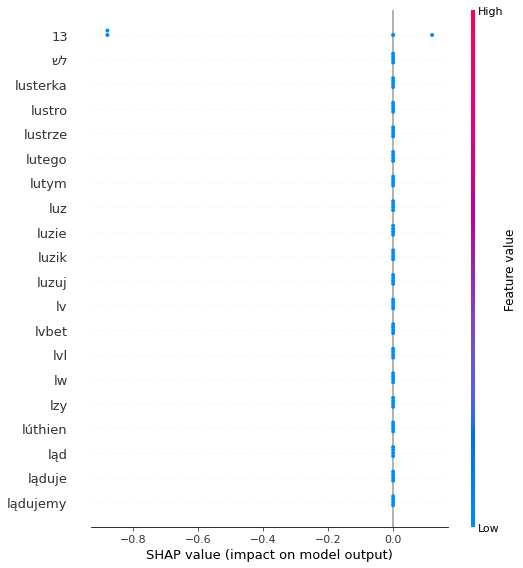

In [83]:
shap.initjs()
shap.summary_plot(gnb01_shap_values[0], np.array([tf_idf[2][TP01_index],
                                                          tf_idf[2][FP01_index],
                                                          tf_idf[2][TN01_index],
                                                          tf_idf[2][FN01_index]]), 
                  feature_names=vectorizer01.get_feature_names())

##### Fasttext
Analizę wykonałam narzędziem podobnym do SHAP, czyli LIME, ponieważ SHAP nie udało mi się uruchomić dla Fasttext oraz Transformators.

Wyniki z LIME są umieszczone w plikach z rozszerzeniem HTML, więc ponownie można je zobaczyć tutaj np. https://nbviewer.jupyter.org/github/JuliaZur/Natural-Language-Processing-Course/blob/master/lab8/lab8.ipynb

In [48]:
def tokenize_string(string):
    return string.split()

def fasttext_prediction_in_sklearn_format(classifier, texts):
    res = []
    
    labels, probabilities = classifier.predict(texts, 10)

    for label, probs, text in zip(labels, probabilities, texts):
        order = np.argsort(np.array(label))
        res.append(probs[order])

    return np.array(res)

In [49]:
test01_texts = [key for key in test01.keys()]
test01_texts_raw = [test01_texts[TP01_index], test01_texts[TN01_index], test01_texts[FP01_index], test01_texts[FN01_index]]
test01_texts_parsed = []

for text in test01_texts:
  if '\n' in text:
    text = text.split('\n')[0]
  test01_texts_parsed.append(text)

In [50]:
explainer = lime.lime_text.LimeTextExplainer(
    split_expression=tokenize_string,
    bow=False,
    class_names=[0, 1]
)

In [57]:
exp = explainer.explain_instance(
    test01_texts_parsed[0],
    classifier_fn=lambda x: fasttext_prediction_in_sklearn_format(model01, x),
    top_labels=1,
    num_features=20,
)
output_filename = data_path + "ft_tp_explanation.html"
exp.save_to_file(output_filename)

IPython.display.HTML(output_filename)

In [58]:
exp = explainer.explain_instance(
    test01_texts_parsed[1],
    classifier_fn=lambda x: fasttext_prediction_in_sklearn_format(model01, x),
    top_labels=1,
    num_features=20,
)
output_filename = data_path + "ft_tn_explanation.html"
exp.save_to_file(output_filename)

IPython.display.HTML(output_filename)

In [59]:
exp = explainer.explain_instance(
    test01_texts_parsed[2],
    classifier_fn=lambda x: fasttext_prediction_in_sklearn_format(model01, x),
    top_labels=1,
    num_features=20,
)
output_filename = data_path + "ft_fp_explanation.html"
exp.save_to_file(output_filename)

IPython.display.HTML(output_filename)

In [60]:
exp = explainer.explain_instance(
    test01_texts_parsed[3],
    classifier_fn=lambda x: fasttext_prediction_in_sklearn_format(model01, x),
    top_labels=1,
    num_features=20,
)
output_filename = data_path + "ft_fn_explanation.html"
exp.save_to_file(output_filename)

IPython.display.HTML(output_filename)

##### BERT model
Shap zbudowałam tylko dla tego modelu, bo mają identyczne wyniki do wielu liczb po przecinku.

In [76]:
def softmax(x):
    e_x = np.exp(x - np.max(x))
    return e_x / e_x.sum(axis=0)

def bert_predict_probs(texts):
    predictions = model01_bert.predict(texts)
    x = np.array(list(predictions)[1])
    return np.apply_along_axis(softmax, 1, x)

In [78]:
exp = explainer.explain_instance(test01_texts_parsed[0], bert_predict_probs, num_features=20)

output_filename = data_path + "bert_tp_explanation.html"
exp.save_to_file(output_filename)

IPython.display.HTML(output_filename)

In [80]:
exp = explainer.explain_instance(test01_texts_parsed[1], bert_predict_probs, num_features=20)

output_filename = data_path + "bert_tn_explanation.html"
exp.save_to_file(output_filename)

IPython.display.HTML(output_filename)

In [81]:
exp = explainer.explain_instance(test01_texts_parsed[2], bert_predict_probs, num_features=20)

output_filename = data_path + "bert_fp_explanation.html"
exp.save_to_file(output_filename)

IPython.display.HTML(output_filename)

In [82]:
exp = explainer.explain_instance(test01_texts_parsed[3], bert_predict_probs, num_features=20)

output_filename = data_path + "bert_fn_explanation.html"
exp.save_to_file(output_filename)

IPython.display.HTML(output_filename)

#### SHAP - task 02

###### Naive Bayes

In [ ]:
gnb02_sample = shap.sample(tf_idf[1], 100) 
gnb02_explainer = shap.KernelExplainer(gnb02.predict_proba, gnb02_sample)
gnb02_shap_values = gnb02_explainer.shap_values(np.array([tf_idf[3][TP02_index], 
                                                          tf_idf[3][TN02_index], 
                                                          tf_idf[3][FP02_index], 
                                                          tf_idf[3][FN02_index]]), 
                                                nsamples=4)

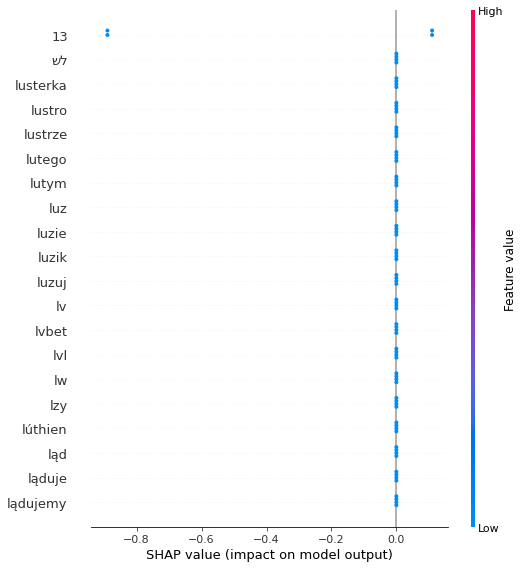

In [114]:
shap.initjs()
shap.summary_plot(gnb02_shap_values[0], np.array([tf_idf[3][TP02_index], 
                                                          tf_idf[3][TN02_index], 
                                                          tf_idf[3][FP02_index], 
                                                          tf_idf[3][FN02_index]]),
                  feature_names=vectorizer02.get_feature_names())

##### Fasttext

In [93]:
test02_texts = [key for key in test02.keys()]
test02_texts_raw = [test02_texts[TP02_index], test02_texts[TN02_index], test02_texts[FP02_index], test02_texts[FN02_index]]
test02_texts_parsed = []

for text in test02_texts:
  if '\n' in text:
    text = text.split('\n')[0]
  test02_texts_parsed.append(text)

In [94]:
explainer02 = lime.lime_text.LimeTextExplainer(
    split_expression=tokenize_string,
    bow=False,
    class_names=[0, 1, 2]
)

In [95]:
exp = explainer02.explain_instance(
    test02_texts_parsed[0],
    classifier_fn=lambda x: fasttext_prediction_in_sklearn_format(model02, x),
    top_labels=1,
    num_features=20,
)
output_filename = data_path + "ft02_tp_explanation.html"
exp.save_to_file(output_filename)

IPython.display.HTML(output_filename)

In [96]:
exp = explainer02.explain_instance(
    test02_texts_parsed[1],
    classifier_fn=lambda x: fasttext_prediction_in_sklearn_format(model02, x),
    top_labels=1,
    num_features=20,
)
output_filename = data_path + "ft02_tn_explanation.html"
exp.save_to_file(output_filename)

IPython.display.HTML(output_filename)

In [97]:
exp = explainer02.explain_instance(
    test02_texts_parsed[2],
    classifier_fn=lambda x: fasttext_prediction_in_sklearn_format(model02, x),
    top_labels=1,
    num_features=20,
)
output_filename = data_path + "ft02_fp_explanation.html"
exp.save_to_file(output_filename)

IPython.display.HTML(output_filename)

In [98]:
exp = explainer02.explain_instance(
    test02_texts_parsed[3],
    classifier_fn=lambda x: fasttext_prediction_in_sklearn_format(model02, x),
    top_labels=1,
    num_features=20,
)
output_filename = data_path + "ft02_tp_explanation.html"
exp.save_to_file(output_filename)

IPython.display.HTML(output_filename)

###### BERT

In [100]:
def bert02_predict_probs(texts):
    predictions = model02_bert.predict(texts)
    x = np.array(list(predictions)[1])
    return np.apply_along_axis(softmax, 1, x)

In [101]:
exp = explainer02.explain_instance(test02_texts_parsed[0], bert02_predict_probs, num_features=20)

output_filename = data_path + "bert02_tp_explanation.html"
exp.save_to_file(output_filename)

IPython.display.HTML(output_filename)

In [102]:
exp = explainer02.explain_instance(test02_texts_parsed[1], bert02_predict_probs, num_features=20)

output_filename = data_path + "bert02_tn_explanation.html"
exp.save_to_file(output_filename)

IPython.display.HTML(output_filename)

In [103]:
exp = explainer02.explain_instance(test02_texts_parsed[2], bert02_predict_probs, num_features=20)

output_filename = data_path + "bert02_fp_explanation.html"
exp.save_to_file(output_filename)

IPython.display.HTML(output_filename)

In [104]:
exp = explainer02.explain_instance(test02_texts_parsed[3], bert02_predict_probs, num_features=20)

output_filename = data_path + "bert02_fn_explanation.html"
exp.save_to_file(output_filename)

IPython.display.HTML(output_filename)

### Answer the following questions:
1. Which of the classifiers works the best for the task 1 and the task 2.

  Dla task 1 najlepiej sprawdził się klasyfikator Naive Bayes.
  W task 2 wszsytkie modele poza Naive Bayes osiągnęły ten sam, niezły wynik.

2. Did you achieve results comparable with the results of PolEval Task?

  Wynik dla najlepszego klasyfikatora jest ok. połowę gorszy niż najlepszy
  rezultat w PolEval Task.

3. Did you achieve results comparabie with the Klej leaderboard?

  Podobnie jak w PolEval wyniki są znacznie gorsze. Chyba żeby patrzeć tylko na 
  accuracy to wówczas nie jest tak źle.

4. Describe strengths and weaknesses of each of the compared algorithms.

  Naive Bayes jest prosty w użyciu i zbadaniu, szybki i daje niezłe wyniki, ale 
  ponieważ operuje na wektorach TF_IDF traci mnóstwo informacji w stosunku do 
  modeli operujących na słowach. Fasttext operuje już na zdaniach, ale jego 
  format danych wejściowych jest nietypowy, nie jest wspierany w SHAP, nie 
  udało mu się też osiągnąć lepszego wyniku w stosunku do modeli BERT i roBERTa,
  które z kolei przyjmują już DataFrame'y, czyli kolejny raz inny format. Poza 
  tym transformatory długo się uczą i długo wykonują predykcje. Na tak bardzo 
  niezbalansowanym zestawie danych te modele nie są w stanie optymalnie 
  pracować.

5. Do you think comparison of raw performance values on a single task is enough to assess the value of a given algorithm/model?

  Niekoniecznie, bo może się okazać, że dobry wynik uzyskany jest tylko na 
  konkretnym zestawie danych. Te wyniki nie uwzględniają, czy modele poprawnymi 
  kierują się poprawnymi w tym zadaniu cechami. Jak widać było np. w Naive 
  Bayes te słowa, które wpływały na wyniki były bezsensowne.

6. Did SHAP show that the models use valuable featurs/words when performing their decision?

  Wyniki z LIME są umieszczone w plikach z rozszerzeniem HTML, więc ponownie można je zobaczyć tutaj np. https://nbviewer.jupyter.org/github/JuliaZur/Natural-Language-Processing-Course/blob/master/lab8/lab8.ipynb

  W Naive Bayes słowa były zupełnie bezsensowne np. '13' lub 'lustro'. Co 
  prawda być może słowo 'lustro' w komentarzach pojawiało się najczęściej w 
  kwestii obrażenia czyjegoś wyglądu, ale to słowo samo w sobie nie świadczy 
  o hejcie. W pozostałych modelach, które przewarzałam LIME zamiast SHAP też pojawiały się bezsensowne słowa jako decydujące o klasie. Co więcej widać, że oprócz Naive Bayes reszta źle zaklasyfikowała FP, FN i TN. Nie są w tej sytuacji lepsze od zgadującego modelu.